# Geodemographic Clustering

In [18]:
import contextily as ctx
import geopandas as gpd
import matplotlib.pyplot as plt
from geosnap import DataStore
from geosnap import analyze as gaz
from geosnap import io as gio
from geosnap import visualize as gvz

In [135]:
%load_ext watermark
%watermark -a  'eli knaap' -iv -d -u

The watermark extension is already loaded. To reload it, use:
  %reload_ext watermark
Author: eli knaap

Last updated: 2024-01-16

geosnap   : 0.12.1.dev9+g3a1cb0f6de61.d20240110
geopandas : 0.14.1
contextily: 1.4.0
matplotlib: 3.8.2



In [2]:
datasets = DataStore()

In [4]:
atl = gio.get_acs(datasets, msa_fips="12060", years=2021, level="tract")

/Users/knaaptime/Dropbox/projects/geosnap/geosnap/io/util.py:275: UserWarning: Unable to find local adjustment year for 2021. Attempting from online data
  warn(
/Users/knaaptime/Dropbox/projects/geosnap/geosnap/io/constructors.py:215: UserWarning: Currency columns unavailable at this resolution; not adjusting for inflation
  warn(


In [8]:
atl[["median_household_income", "geometry"]].explore(
    "median_household_income",
    scheme="quantiles",
    k=8,
    cmap="magma",
    tiles="CartoDB Positron",
)

In [9]:
atl.columns

Index(['geoid', 'n_mexican_pop', 'n_cuban_pop', 'n_puerto_rican_pop',
       'n_russian_pop', 'n_italian_pop', 'n_german_pop', 'n_irish_pop',
       'n_scandaniavian_pop', 'n_foreign_born_pop',
       ...
       'p_poverty_rate', 'p_poverty_rate_over_65', 'p_poverty_rate_children',
       'p_poverty_rate_white', 'p_poverty_rate_black',
       'p_poverty_rate_hispanic', 'p_poverty_rate_native',
       'p_poverty_rate_asian', 'geometry', 'year'],
      dtype='object', length=158)

In [14]:
columns = [
    "median_household_income",
    "median_home_value",
    "p_edu_college_greater",
    "p_edu_hs_less",
    "p_nonhisp_white_persons",
    "p_nonhisp_black_persons",
    "p_hispanic_persons",
    "p_asian_persons",
]

In [15]:
atl[columns]

,median_household_income,median_home_value,p_edu_college_greater,p_edu_hs_less,p_nonhisp_white_persons,p_nonhisp_black_persons,p_hispanic_persons,p_asian_persons
0,100046.0,269800.0,36.410007,7.772650,66.726619,13.979725,8.371485,7.406802
1,68911.0,161700.0,13.808050,17.275542,66.060862,6.170752,22.104818,2.831784
2,78712.0,202100.0,14.972459,16.374562,70.527071,1.470061,18.465400,7.995697
3,53072.0,162000.0,9.760178,17.735639,64.627151,8.604207,19.005736,3.288719
4,64917.0,159100.0,23.516484,14.212454,70.119425,1.852303,12.576164,14.184743
...,...,...,...,...,...,...,...,...
1495,61926.0,178700.0,14.130691,11.040340,85.844513,5.177159,4.179567,2.149983
1496,65139.0,230800.0,29.907407,7.731481,72.192354,18.906810,4.121864,4.510155
1497,53805.0,190100.0,12.632922,28.966397,54.473684,28.479532,9.269006,0.672515
1498,80037.0,215100.0,24.821630,18.700713,71.843402,20.948924,6.844698,0.000000


## Cross-Sectional Clustering

In [100]:
atl_kmeans, atl_k_model = gaz.cluster(
    gdf=atl, method="kmeans", n_clusters=5, columns=columns, return_model=True
)

/Users/knaaptime/mambaforge/envs/geosnap/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1420: FutureWarning: algorithm='auto' is deprecated, it will be removed in 1.3. Using 'lloyd' instead.
  warnings.warn(


In [107]:
atl_kmeans[columns + ["geometry", "kmeans"]].explore(
    "kmeans", categorical=True, cmap="Accent", tiles="CartoDB Positron"
)

There are two obvious patterns in this map. There's an urban-rural distinction, where type 1 dominates the periphery of the metro, and is basically absent from the core. There is also a north-south distinction, where type 0 is exclusively located in the southern portion and type 3 is exclusively in the north. Types 2 and 4 seem to have their own distinctive pockets. Even at this surface level, the map tells a pretty powerful story about multivariate segregation in the region. The kmeans clustering algorithm *does not consider space at all*, yet all of the types form distinctive __spatial__ clusters that are apparent in the map. We can also conduct formal tests for whether these patterns diverge from spatial randomness using join count statistics either individually for each cluster or jointly for all clusters (though it is pretty obvious here that a [co-location statistic](https://geodacenter.github.io/workbook/6d_local_discrete/lab6d.html#co-location-join-count-statistic) for these five variables would be wildly significant)

To understand what the clusters are identifying, another data visualisation technique is useful. Here, we rely on the Tufte-ian principle of "small multiples", and create a set of violin plots that show how each variable is distributed across each of the clusters. Each of the inset boxes shows a different variable, with cluster assignments on the x-axis, and the variable itself on the y-axis The boxplot in the center shows the median and IQR, and the "body" of the "violin" is a kernel-density estimate reflected across the x-axis. In short, the fat parts of the violin show where the bulk of the observations are located, and the skinny "necks" show the long tails.

array([<Axes: title={'center': 'median_household_income'}, xlabel='kmeans', ylabel='median_household_income'>,
       <Axes: title={'center': 'median_home_value'}, xlabel='kmeans', ylabel='median_home_value'>,
       <Axes: title={'center': 'p_edu_college_greater'}, xlabel='kmeans', ylabel='p_edu_college_greater'>,
       <Axes: title={'center': 'p_edu_hs_less'}, xlabel='kmeans', ylabel='p_edu_hs_less'>,
       <Axes: title={'center': 'p_nonhisp_white_persons'}, xlabel='kmeans', ylabel='p_nonhisp_white_persons'>,
       <Axes: title={'center': 'p_nonhisp_black_persons'}, xlabel='kmeans', ylabel='p_nonhisp_black_persons'>,
       <Axes: title={'center': 'p_hispanic_persons'}, xlabel='kmeans', ylabel='p_hispanic_persons'>,
       <Axes: title={'center': 'p_asian_persons'}, xlabel='kmeans', ylabel='p_asian_persons'>,
       <Axes: >], dtype=object)

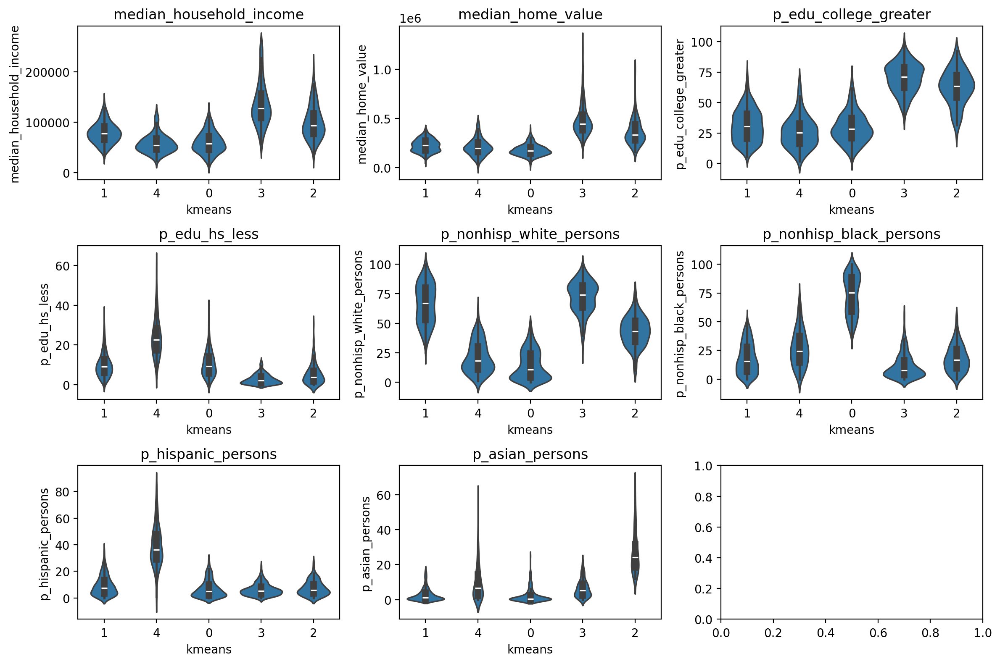

In [111]:
gvz.plot_violins_by_cluster(atl_kmeans, columns, cluster_col="kmeans")

Note that in this case we are visualizing the same attributes used to create the cluster model because this is what differentiates the clusters from one another, but the `columns` argument accepts a list of any variables present in the dataframe. This can be useful for examining the distribution of another variable across the clusters. For example if the clusters are based purely on sociodemographic data and an analyst wants to treat cluster assignments as "exogenous" and examine how another resource like affordable housing or exposure to pollution is spread across the different neighborhood types

<Axes: title={'center': 'Silhouette Score'}, xlabel='Silhouette coefficient values', ylabel='Cluster label'>

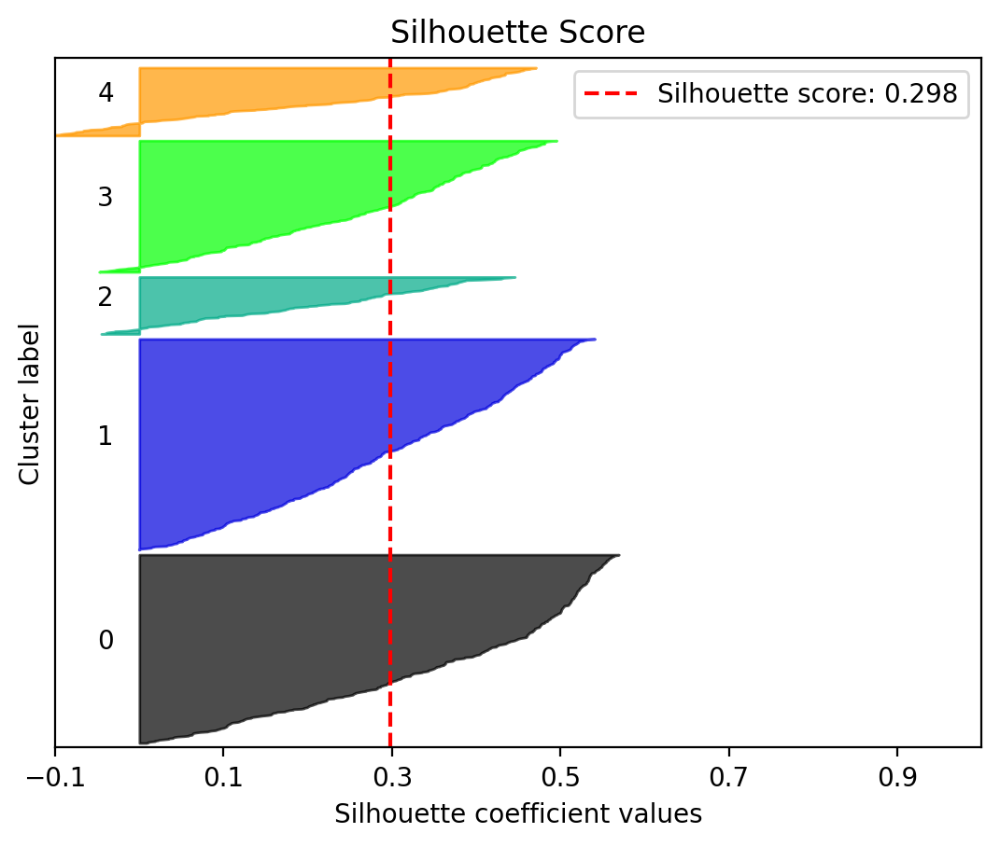

In [108]:
atl_k_model.plot_silhouette()

/Users/knaaptime/Dropbox/projects/geosnap/geosnap/visualize/mapping.py:170: UserWarning: `proplot` is not installed.  Falling back to matplotlib
  warn("`proplot` is not installed.  Falling back to matplotlib")


[<Axes: title={'center': '2021'}>]

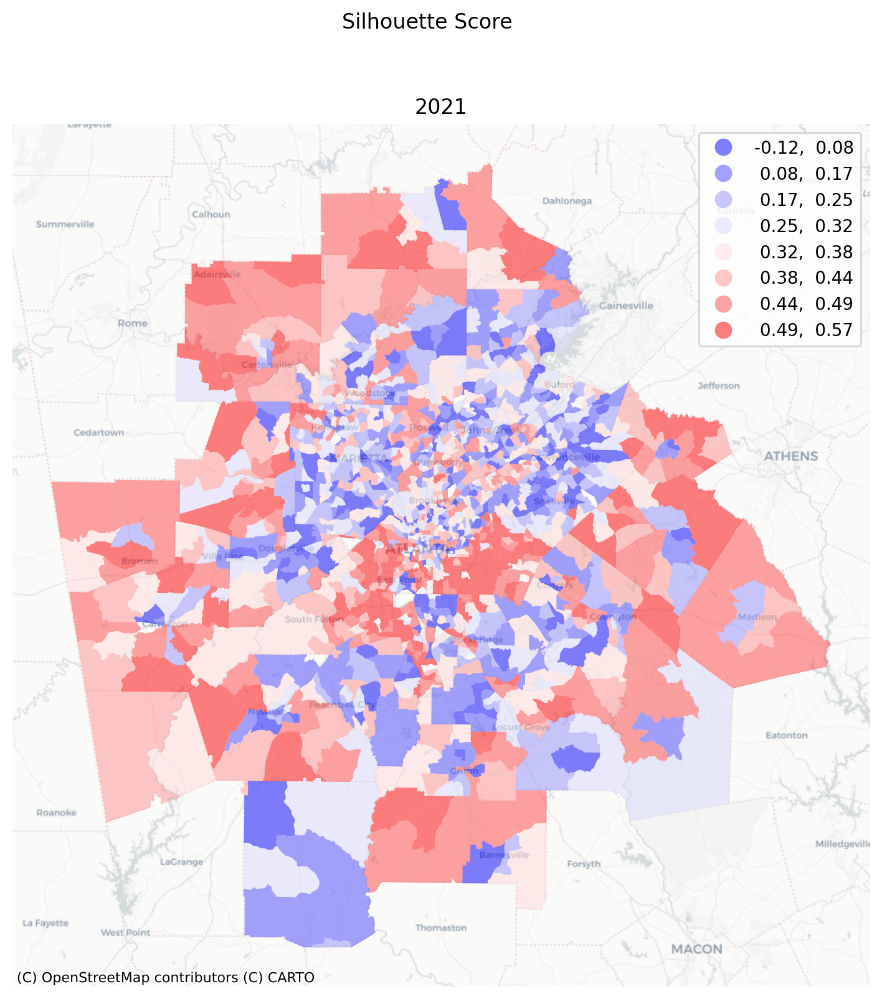

In [116]:
atl_k_model.plot_silhouette_map(figsize=(9, 9))

If there is spatial patterning in the silhouette scores for each observation, then it suggests there are *particular places* where the cluster model does not fit well. That could mean that a different model may work better, e.g. by increasing (or decreasing) the number of clusters, or by using a different clustering algorithm. There are many algorithms to choose from, and they differ in their ability to capture different kinds of structure in the set of attributes. For more details, see the [`scikit-learn` clustering page](https://scikit-learn.org/stable/modules/clustering.html), including this excellent graphic:

![Cluster Types](https://scikit-learn.org/stable/_images/sphx_glr_plot_cluster_comparison_001.png)

In [16]:
cluster_types = [
    "kmeans",
    "ward",
    "affinity_propagation",
    "gaussian_mixture",
    "spectral",
]

/Users/knaaptime/mambaforge/envs/geosnap/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1420: FutureWarning: algorithm='auto' is deprecated, it will be removed in 1.3. Using 'lloyd' instead.
  warnings.warn(
/Users/knaaptime/Dropbox/projects/geosnap/geosnap/analyze/_cluster_wrappers.py:272: UserWarning: Note: Gaussian Mixture Clustering is probabilistic--cluster labels may be different for different runs. If you need consistency, you should set the `random_state` parameter
  warn(


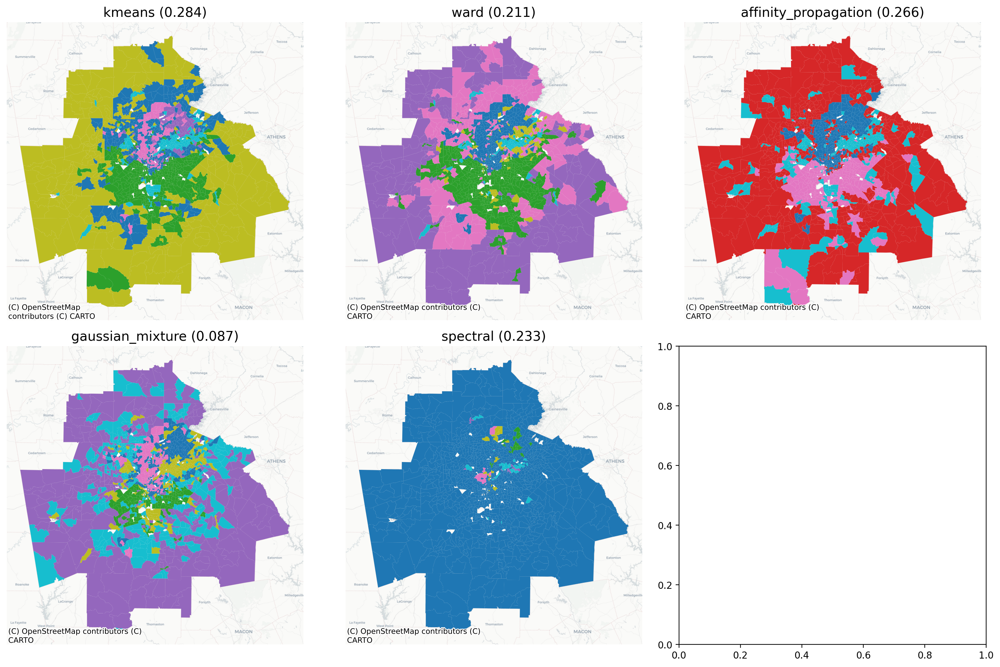

In [118]:
f, ax = plt.subplots(2, 3, figsize=(15, 10))
ax = ax.flatten()

for i, k in enumerate(cluster_types):
    df, mod = gaz.cluster(
        gdf=atl, method=k, columns=columns, n_clusters=6, return_model=True
    )
    df.to_crs(3857).sort_values(k).plot(k, categorical=True, figsize=(7, 7), ax=ax[i])
    ax[i].axis("off")
    ax[i].set_title(k + f" ({mod.silhouette_score.round(3)})", fontsize=14)
    ctx.add_basemap(ax=ax[i], source=ctx.providers.CartoDB.Positron)
    plt.tight_layout()

Note that the colors do not mean anything when comparing across maps, only the patterns matter. Thus, even though the kmeans, ward, and affinity propagation maps use different colors, the algorithms are largely capturing similar patterns, as the tracts tend to end up in similar groups across the maps. According to the silhouette score, the kmeans solution fits the best (.284). 

In [127]:
ks_best, ks_table = gaz.find_k(gdf=atl, method='kmeans', columns=columns, min_k=2, max_k=10, return_table=True)

  0%|          | 0/9 [00:00<?, ?it/s]

/Users/knaaptime/mambaforge/envs/geosnap/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1420: FutureWarning: algorithm='auto' is deprecated, it will be removed in 1.3. Using 'lloyd' instead.
  warnings.warn(
/Users/knaaptime/mambaforge/envs/geosnap/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1420: FutureWarning: algorithm='auto' is deprecated, it will be removed in 1.3. Using 'lloyd' instead.
  warnings.warn(
/Users/knaaptime/mambaforge/envs/geosnap/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1420: FutureWarning: algorithm='auto' is deprecated, it will be removed in 1.3. Using 'lloyd' instead.
  warnings.warn(
/Users/knaaptime/mambaforge/envs/geosnap/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1420: FutureWarning: algorithm='auto' is deprecated, it will be removed in 1.3. Using 'lloyd' instead.
  warnings.warn(
/Users/knaaptime/mambaforge/envs/geosnap/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1420: FutureWarning: algorithm='aut

In [137]:
ks_best

,best_k
silhouette_score,2
calinski_harabasz_score,2
davies_bouldin_score,6


In [138]:
ks_table.columns

Index(['silhouette_score', 'calinski_harabasz_score', 'davies_bouldin_score'], dtype='object')

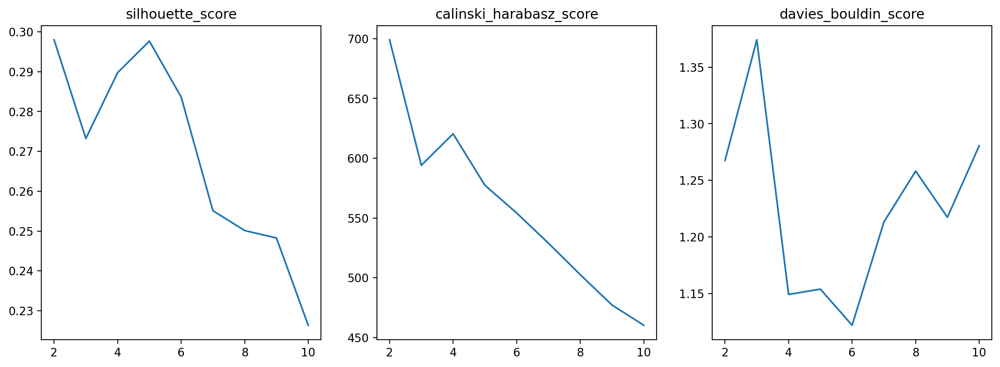

In [156]:
f, ax = plt.subplots(1,3, figsize=(15,5))
ax=ax.flatten()

for i, metric in enumerate(ks_table.columns.values):
    ks_table[metric].plot(ax=ax[i])
    ax[i].set_title(metric)

The units here do not matter, so the values on the y-axis can be safely ignored; what matters for these metrics are the min/max values which describe the best or worst fitting cluster models (depending the metric) for these data. For the silhouette score and the Calinski-Harabasz scores, the highest score fits best, whereas for the Davies Bouldin, the lowest score has the best fit. 